In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
import warnings
warnings.filterwarnings('ignore')

In [3]:
df=pd.read_csv('mushrooms.csv')

In [4]:
df.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,p,x,s,n,t,p,f,c,n,k,...,s,w,w,p,w,o,p,k,s,u
1,e,x,s,y,t,a,f,c,b,k,...,s,w,w,p,w,o,p,n,n,g
2,e,b,s,w,t,l,f,c,b,n,...,s,w,w,p,w,o,p,n,n,m
3,p,x,y,w,t,p,f,c,n,n,...,s,w,w,p,w,o,p,k,s,u
4,e,x,s,g,f,n,f,w,b,k,...,s,w,w,p,w,o,e,n,a,g


In [5]:
df.shape

(8124, 23)

In [6]:
df.dtypes

class                       object
cap-shape                   object
cap-surface                 object
cap-color                   object
bruises                     object
odor                        object
gill-attachment             object
gill-spacing                object
gill-size                   object
gill-color                  object
stalk-shape                 object
stalk-root                  object
stalk-surface-above-ring    object
stalk-surface-below-ring    object
stalk-color-above-ring      object
stalk-color-below-ring      object
veil-type                   object
veil-color                  object
ring-number                 object
ring-type                   object
spore-print-color           object
population                  object
habitat                     object
dtype: object

In [7]:
df.describe()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
count,8124,8124,8124,8124,8124,8124,8124,8124,8124,8124,...,8124,8124,8124,8124,8124,8124,8124,8124,8124,8124
unique,2,6,4,10,2,9,2,2,2,12,...,4,9,9,1,4,3,5,9,6,7
top,e,x,y,n,f,n,f,c,b,b,...,s,w,w,p,w,o,p,w,v,d
freq,4208,3656,3244,2284,4748,3528,7914,6812,5612,1728,...,4936,4464,4384,8124,7924,7488,3968,2388,4040,3148


In [8]:
df.dtypes

class                       object
cap-shape                   object
cap-surface                 object
cap-color                   object
bruises                     object
odor                        object
gill-attachment             object
gill-spacing                object
gill-size                   object
gill-color                  object
stalk-shape                 object
stalk-root                  object
stalk-surface-above-ring    object
stalk-surface-below-ring    object
stalk-color-above-ring      object
stalk-color-below-ring      object
veil-type                   object
veil-color                  object
ring-number                 object
ring-type                   object
spore-print-color           object
population                  object
habitat                     object
dtype: object

In [9]:
df.isnull().sum()

class                       0
cap-shape                   0
cap-surface                 0
cap-color                   0
bruises                     0
odor                        0
gill-attachment             0
gill-spacing                0
gill-size                   0
gill-color                  0
stalk-shape                 0
stalk-root                  0
stalk-surface-above-ring    0
stalk-surface-below-ring    0
stalk-color-above-ring      0
stalk-color-below-ring      0
veil-type                   0
veil-color                  0
ring-number                 0
ring-type                   0
spore-print-color           0
population                  0
habitat                     0
dtype: int64

<AxesSubplot:>

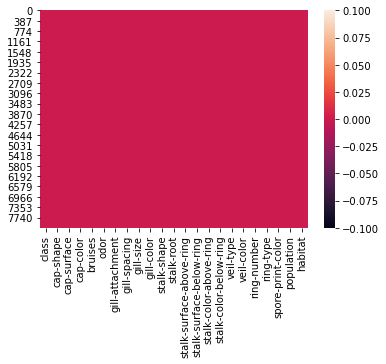

In [10]:
sns.heatmap(df.isnull())

In [11]:
pd.set_option('display.max_rows',None)

In [12]:
df.shape

(8124, 23)

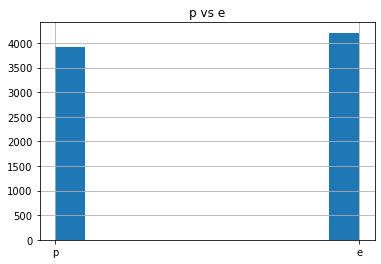

In [13]:
df["class"].hist(grid=True)
plt.title("p vs e")
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


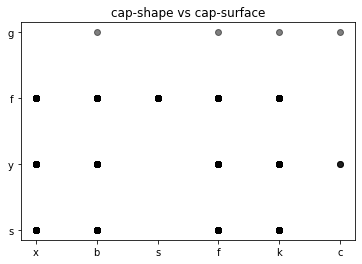

In [14]:
plt.scatter(df["cap-shape"],df["cap-surface"],alpha=0.5,c=(0,0,0))
plt.title("cap-shape vs cap-surface")
plt.show()

In [15]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
list1=['class','cap-shape','cap-surface','cap-color','bruises','odor','gill-attachment','gill-spacing','gill-size','gill-color','stalk-shape','stalk-root','stalk-surface-above-ring','stalk-surface-below-ring','stalk-color-above-ring','stalk-color-below-ring','veil-type','veil-color','ring-number','ring-type','spore-print-color','population','population','habitat']
for val in list1:
    df[val]=le.fit_transform(df[val].astype(str))

In [16]:
df

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,1,5,2,4,1,6,1,0,1,4,...,2,7,7,0,2,1,4,2,3,5
1,0,5,2,9,1,0,1,0,0,4,...,2,7,7,0,2,1,4,3,2,1
2,0,0,2,8,1,3,1,0,0,5,...,2,7,7,0,2,1,4,3,2,3
3,1,5,3,8,1,6,1,0,1,5,...,2,7,7,0,2,1,4,2,3,5
4,0,5,2,3,0,5,1,1,0,4,...,2,7,7,0,2,1,0,3,0,1
5,0,5,3,9,1,0,1,0,0,5,...,2,7,7,0,2,1,4,2,2,1
6,0,0,2,8,1,0,1,0,0,2,...,2,7,7,0,2,1,4,2,2,3
7,0,0,3,8,1,3,1,0,0,5,...,2,7,7,0,2,1,4,3,3,3
8,1,5,3,8,1,6,1,0,1,7,...,2,7,7,0,2,1,4,2,4,1
9,0,0,2,9,1,0,1,0,0,2,...,2,7,7,0,2,1,4,2,3,3


In [17]:
corr_matrix=df.corr()
corr_matrix["class"].sort_values(ascending=False)

class                       1.000000
gill-size                   0.540024
population                  0.298686
habitat                     0.217179
cap-surface                 0.178446
spore-print-color           0.171961
veil-color                  0.145142
gill-attachment             0.129200
cap-shape                   0.052951
cap-color                  -0.031384
odor                       -0.093552
stalk-shape                -0.102019
stalk-color-below-ring     -0.146730
stalk-color-above-ring     -0.154003
ring-number                -0.214366
stalk-surface-below-ring   -0.298801
stalk-surface-above-ring   -0.334593
gill-spacing               -0.348387
stalk-root                 -0.379361
ring-type                  -0.411771
bruises                    -0.501530
gill-color                 -0.530566
veil-type                        NaN
Name: class, dtype: float64

In [18]:
#corr_matrix.plot(kind='density',subplots=True,layout=(6,11), sharex=False,legend=False,fontsize=1,figsize=(18,12))
#plt.show()

In [19]:
df.corr()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
class,1.000000,0.052951,0.178446,-0.031384,-0.501530,-0.093552,0.129200,-0.348387,0.540024,-0.530566,...,-0.298801,-0.154003,-0.146730,NaN,0.145142,-0.214366,-0.411771,0.171961,0.298686,0.217179
cap-shape,0.052951,1.000000,-0.050454,-0.048203,-0.035374,-0.021935,0.078865,0.013196,0.054050,-0.006039,...,-0.032591,-0.031659,-0.030390,NaN,0.072560,-0.106534,-0.025457,-0.073416,0.063413,-0.042221
cap-surface,0.178446,-0.050454,1.000000,-0.019402,0.070228,0.045233,-0.034180,-0.282306,0.208100,-0.161017,...,0.107965,0.066050,0.068885,NaN,-0.016603,-0.026147,-0.106407,0.230364,0.021555,0.163887
cap-color,-0.031384,-0.048203,-0.019402,1.000000,-0.000764,-0.387121,0.041436,0.144259,-0.169464,0.084659,...,-0.047710,0.002364,0.008057,NaN,0.036130,-0.005822,0.162513,-0.293523,-0.144770,0.033925
bruises,-0.501530,-0.035374,0.070228,-0.000764,1.000000,-0.061825,0.137359,-0.299473,-0.369596,0.527120,...,0.458983,0.083538,0.092874,NaN,0.119770,0.056788,0.692973,-0.285008,0.088137,-0.075095
odor,-0.093552,-0.021935,0.045233,-0.387121,-0.061825,1.000000,-0.059590,0.063936,0.310495,-0.129213,...,0.061820,0.174532,0.169407,NaN,-0.057747,0.111905,-0.281387,0.469055,-0.043623,-0.026610
gill-attachment,0.129200,0.078865,-0.034180,0.041436,0.137359,-0.059590,1.000000,0.071489,0.108984,-0.128567,...,-0.116177,0.099299,0.097160,NaN,0.897518,0.093236,-0.146689,-0.029524,0.165575,-0.030304
gill-spacing,-0.348387,0.013196,-0.282306,0.144259,-0.299473,0.063936,0.071489,1.000000,-0.108333,0.100193,...,-0.213775,0.274574,0.253505,NaN,0.073363,0.243014,-0.195897,0.047323,-0.529253,-0.154680
gill-size,0.540024,0.054050,0.208100,-0.169464,-0.369596,0.310495,0.108984,-0.108333,1.000000,-0.516736,...,0.010894,0.296548,0.278708,NaN,0.103809,-0.171362,-0.460872,0.622991,0.147682,0.161418
gill-color,-0.530566,-0.006039,-0.161017,0.084659,0.527120,-0.129213,-0.128567,0.100193,-0.516736,1.000000,...,0.257224,-0.058299,-0.074781,NaN,-0.097583,0.096054,0.629398,-0.416135,-0.034090,-0.202972


<AxesSubplot:>

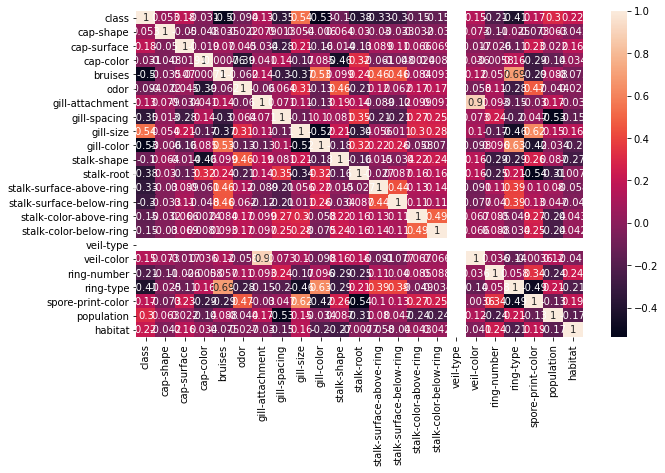

In [20]:
plt.figure(figsize=(10,6))
sns.heatmap(df.corr(),annot=True)

In [21]:
for col in df.columns:
    if df.skew().loc[col]>0.55:
        df[col]=np.log1p(df[col])

In [22]:
df=df.drop(['veil-type'],axis=1)

<AxesSubplot:>

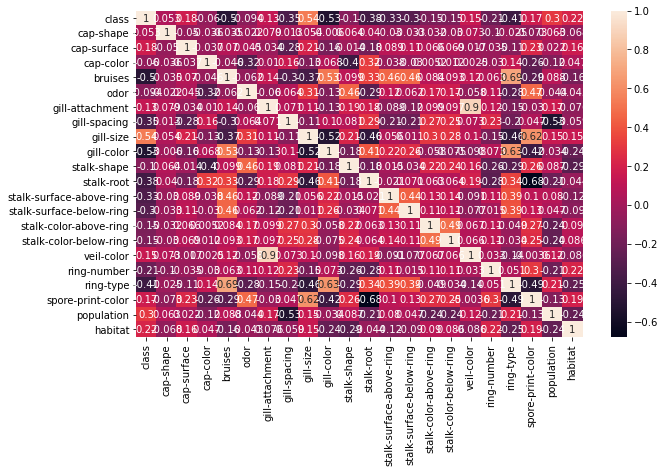

In [23]:
plt.figure(figsize=(10,6))
sns.heatmap(df.corr(),annot=True)

In [24]:
df.skew()

class                       0.071946
cap-shape                  -0.247052
cap-surface                -0.590859
cap-color                  -0.365280
bruises                     0.342750
odor                       -0.080790
gill-attachment            -5.977076
gill-spacing                1.840088
gill-size                   0.825797
gill-color                  0.061410
stalk-shape                -0.271345
stalk-root                  0.129453
stalk-surface-above-ring   -1.098739
stalk-surface-below-ring   -0.757703
stalk-color-above-ring     -1.835434
stalk-color-below-ring     -1.791593
veil-color                 -6.946944
ring-number                 1.481287
ring-type                  -0.290018
spore-print-color           0.548426
population                 -1.413096
habitat                     0.342186
dtype: float64

In [25]:
#from sklearn.preprocessing import power_transform
#df_new=power_transform(df)

#df_new=pd.DataFrame(df_new,columns=df.columns)

In [26]:
#df_new.skew()

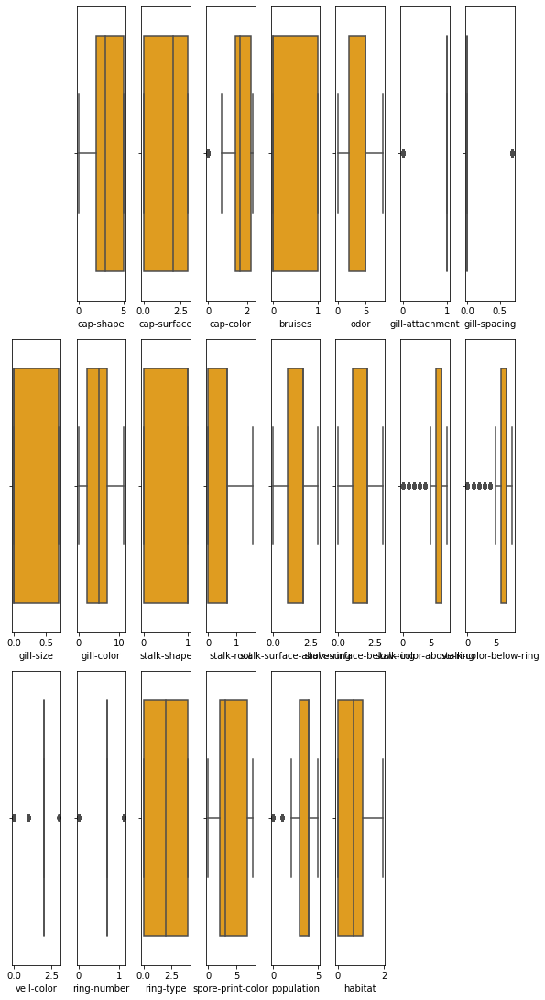

In [27]:
col=df.columns.values
ncol=8
nrow=8
plt.figure(figsize=(ncol,5*ncol))
for i in range(1,len(col)):
    plt.subplot(nrow,ncol,i+1)
    sns.boxplot(df[col[i]],color='orange',orient='h')
    plt.tight_layout()

In [28]:
from scipy.stats import zscore
z_score=abs(zscore(df))
print(df.shape)
df_new=df.loc[(z_score<3).all(axis=1)]
print(df_new.shape)

(8124, 22)
(6472, 22)


In [29]:
df_new

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-above-ring,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,1,5,2,1.609438,1,6,1,0.000000,0.693147,4,...,2,2,7,7,2,0.693147,4,2,3,1.791759
1,0,5,2,2.302585,1,0,1,0.000000,0.000000,4,...,2,2,7,7,2,0.693147,4,3,2,0.693147
2,0,0,2,2.197225,1,3,1,0.000000,0.000000,5,...,2,2,7,7,2,0.693147,4,3,2,1.386294
3,1,5,3,2.197225,1,6,1,0.000000,0.693147,5,...,2,2,7,7,2,0.693147,4,2,3,1.791759
4,0,5,2,1.386294,0,5,1,0.693147,0.000000,4,...,2,2,7,7,2,0.693147,0,3,0,0.693147
5,0,5,3,2.302585,1,0,1,0.000000,0.000000,5,...,2,2,7,7,2,0.693147,4,2,2,0.693147
6,0,0,2,2.197225,1,0,1,0.000000,0.000000,2,...,2,2,7,7,2,0.693147,4,2,2,1.386294
7,0,0,3,2.197225,1,3,1,0.000000,0.000000,5,...,2,2,7,7,2,0.693147,4,3,3,1.386294
8,1,5,3,2.197225,1,6,1,0.000000,0.693147,7,...,2,2,7,7,2,0.693147,4,2,4,0.693147
9,0,0,2,2.302585,1,0,1,0.000000,0.000000,2,...,2,2,7,7,2,0.693147,4,2,3,1.386294


In [30]:
x=df_new.iloc[:,1:-1]
x

,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,stalk-shape,stalk-root,stalk-surface-above-ring,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-color,ring-number,ring-type,spore-print-color,population
0,5,2,1.609438,1,6,1,0.000000,0.693147,4,0,1.386294,2,2,7,7,2,0.693147,4,2,3
1,5,2,2.302585,1,0,1,0.000000,0.000000,4,0,1.098612,2,2,7,7,2,0.693147,4,3,2
2,0,2,2.197225,1,3,1,0.000000,0.000000,5,0,1.098612,2,2,7,7,2,0.693147,4,3,2
3,5,3,2.197225,1,6,1,0.000000,0.693147,5,0,1.386294,2,2,7,7,2,0.693147,4,2,3
4,5,2,1.386294,0,5,1,0.693147,0.000000,4,1,1.386294,2,2,7,7,2,0.693147,0,3,0
5,5,3,2.302585,1,0,1,0.000000,0.000000,5,0,1.098612,2,2,7,7,2,0.693147,4,2,2
6,0,2,2.197225,1,0,1,0.000000,0.000000,2,0,1.098612,2,2,7,7,2,0.693147,4,2,2
7,0,3,2.197225,1,3,1,0.000000,0.000000,5,0,1.098612,2,2,7,7,2,0.693147,4,3,3
8,5,3,2.197225,1,6,1,0.000000,0.693147,7,0,1.386294,2,2,7,7,2,0.693147,4,2,4
9,0,2,2.302585,1,0,1,0.000000,0.000000,2,0,1.098612,2,2,7,7,2,0.693147,4,2,3


In [31]:
x.shape

(6472, 20)

In [32]:
y=df_new.iloc[:,0]
y

0       1
1       0
2       0
3       1
4       0
5       0
6       0
7       0
8       1
9       0
10      0
11      0
12      0
13      1
14      0
15      0
16      0
17      1
18      1
19      1
20      0
21      1
22      0
23      0
24      0
25      1
26      0
27      0
28      0
29      0
30      0
31      1
32      0
33      0
34      0
35      0
36      0
37      1
38      0
39      0
40      0
41      0
42      0
43      1
44      0
45      0
46      0
47      0
48      0
49      0
50      0
51      0
52      0
53      1
54      1
55      0
56      0
57      0
58      0
59      0
60      0
61      0
62      0
63      0
64      0
65      0
66      0
67      0
68      0
69      0
70      0
71      0
72      0
73      0
74      0
75      0
76      0
77      0
78      1
79      0
80      0
81      1
82      0
83      0
84      0
85      0
86      0
87      0
88      0
89      0
90      0
91      0
92      0
93      0
94      0
95      0
96      0
97      0
98      0
99      0


In [33]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.22,random_state=43)

In [34]:
lr=LogisticRegression()

In [35]:
lr.fit(x_train,y_train)
lr.score(x_train,y_train)
pred=lr.predict(x_test)
print(accuracy_score(y_test,pred))
print(confusion_matrix(y_test,pred))
print(classification_report(y_test,pred))

0.9662921348314607
[[733  18]
 [ 30 643]]
              precision    recall  f1-score   support

           0       0.96      0.98      0.97       751
           1       0.97      0.96      0.96       673

    accuracy                           0.97      1424
   macro avg       0.97      0.97      0.97      1424
weighted avg       0.97      0.97      0.97      1424



In [36]:
lrscores=cross_val_score(lr,x,y,cv=6)
print(lrscores)
print(lrscores.mean(),lrscores.std())

[0.7497683  0.91195551 0.90917516 0.99907322 1.         0.92207792]
0.9153416864260238 0.08335407720294864


In [37]:
rf=RandomForestClassifier()
rf.fit(x_train,y_train)
predrf=rf.predict(x_test)
print(accuracy_score(y_test,predrf))
print(confusion_matrix(y_test,predrf))
print(classification_report(y_test,predrf))

1.0
[[751   0]
 [  0 673]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       751
           1       1.00      1.00      1.00       673

    accuracy                           1.00      1424
   macro avg       1.00      1.00      1.00      1424
weighted avg       1.00      1.00      1.00      1424



In [38]:
rfscores=cross_val_score(rf,x,y,cv=6)
print(rfscores)
print(rfscores.mean(),rfscores.std())

[0.76274328 1.         1.         1.         1.         0.9109462 ]
0.9456149129126755 0.08801032562756267


In [39]:
svc=SVC(kernel='rbf')
svc.fit(x_train,y_train)
svc.score(x_train,y_train)
predsvc=svc.predict(x_test)
print(accuracy_score(y_test,predsvc))
print(confusion_matrix(y_test,predsvc))
print(classification_report(y_test,predsvc))

0.9950842696629213
[[749   2]
 [  5 668]]
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       751
           1       1.00      0.99      0.99       673

    accuracy                           1.00      1424
   macro avg       1.00      0.99      1.00      1424
weighted avg       1.00      1.00      1.00      1424



In [40]:
svcscores=cross_val_score(svc,x,y,cv=6)
print(svcscores)
print(svcscores.mean(),svcscores.std())

[0.74235403 0.98702502 0.89620019 1.         1.         0.9109462 ]
0.9227542394495923 0.0907866834707313


In [41]:
knn=KNeighborsClassifier()
knn.fit(x_train,y_train)
knn.score(x_train,y_train)
predknn=knn.predict(x_test)
print(accuracy_score(y_test,predknn))
print(confusion_matrix(y_test,predknn))
print(classification_report(y_test,predknn))

0.9985955056179775
[[749   2]
 [  0 673]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       751
           1       1.00      1.00      1.00       673

    accuracy                           1.00      1424
   macro avg       1.00      1.00      1.00      1424
weighted avg       1.00      1.00      1.00      1424



In [42]:
knnscores=cross_val_score(knn,x,y,cv=6)
print(knnscores)
print(knnscores.mean(),knnscores.std())

[0.74513438 0.99258573 0.9592215  1.         1.         0.9554731 ]
0.942069118489084 0.08992688005587735


In [43]:
gnb=GaussianNB()
gnb.fit(x_train,y_train)
gnb.score(x_train,y_train)
predgnb=gnb.predict(x_test)
print(accuracy_score(y_test,predgnb))
print(confusion_matrix(y_test,predgnb))
print(classification_report(y_test,predgnb))

0.860252808988764
[[727  24]
 [175 498]]
              precision    recall  f1-score   support

           0       0.81      0.97      0.88       751
           1       0.95      0.74      0.83       673

    accuracy                           0.86      1424
   macro avg       0.88      0.85      0.86      1424
weighted avg       0.88      0.86      0.86      1424



In [44]:
gnbscores=cross_val_score(gnb,x,y,cv=6)
print(gnbscores)
print(gnbscores.mean(),gnbscores.std())

[0.63670065 0.59499537 0.81000927 1.         1.         0.9109462 ]
0.8254419132216034 0.16187396144002575


In [45]:
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
dtc.score(x_train,y_train)
preddtc=dtc.predict(x_test)
print(accuracy_score(y_test,preddtc))
print(confusion_matrix(y_test,preddtc))
print(classification_report(y_test,preddtc))

1.0
[[751   0]
 [  0 673]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       751
           1       1.00      1.00      1.00       673

    accuracy                           1.00      1424
   macro avg       1.00      1.00      1.00      1424
weighted avg       1.00      1.00      1.00      1424



In [46]:
dtcscores=cross_val_score(dtc,x,y,cv=6)
print(dtcscores)
print(dtcscores.mean(),dtcscores.std())

[0.88137164 1.         0.99629286 1.         1.         0.92207792]
0.9666237377080752 0.04738922430053694


In [52]:
from sklearn.model_selection import GridSearchCV

In [56]:
parameters ={'max_depth':np.arange(2,15),
           'criterion':['gini','entropy']}

In [57]:
GCV=GridSearchCV(DecisionTreeClassifier(),parameters,cv=5)

In [58]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14])})

In [59]:
GCV.best_params_

{'criterion': 'gini', 'max_depth': 6}

In [61]:
GCV_pred=GCV.best_estimator_.predict(x_test)

In [62]:
accuracy_score(y_test,GCV_pred)

1.0

In [63]:
import joblib
joblib.dump(GCV.best_estimator_,"mushroomfinalDTC.pkl")

['mushroomfinalDTC.pkl']